In [14]:
import numpy as np
import librosa
import os
import pandas as pd

df = pd.read_csv("labeled_data.csv")
print(df["label"].value_counts())
folder = "./WAVs"

def extract_mfcc(file_path):
    try:
        y, sr = librosa.load(file_path, sr=16000)
        mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)
        mfcc_mean = np.mean(mfcc, axis=1) 
        return mfcc_mean
    except Exception as e:
        print(f"Failed to extract MFCC from {file_path}: {e}")
        return np.zeros(13)


mfcc_features = []

for i, row in df.iterrows():
    path = os.path.join(folder, row["filename"])
    print(f"Extracting MFCC for: {row['filename']}...")
    features = extract_mfcc(path)
    mfcc_features.append(features)

# Convert to NumPy array
X = np.array(mfcc_features)  # Feature matrix


np.save("mfcc_features.npy", X)
print("MFCC features saved to mfcc_features.npy")

label
Fast     462
Ideal    340
Slow      26
Name: count, dtype: int64
Extracting MFCC for: ielts-listening-0092-cam14-test-3-part-4.wav...
Failed to extract MFCC from ./WAVs/ielts-listening-0092-cam14-test-3-part-4.wav: [Errno 2] No such file or directory: './WAVs/ielts-listening-0092-cam14-test-3-part-4.wav'
Extracting MFCC for: short-stories-0207-209-sport-canada.wav...
Failed to extract MFCC from ./WAVs/short-stories-0207-209-sport-canada.wav: [Errno 2] No such file or directory: './WAVs/short-stories-0207-209-sport-canada.wav'
Extracting MFCC for: short-stories-0264-267-etiquette.wav...
Failed to extract MFCC from ./WAVs/short-stories-0264-267-etiquette.wav: [Errno 2] No such file or directory: './WAVs/short-stories-0264-267-etiquette.wav'
Extracting MFCC for: short-stories-0212-214-nike.wav...
Failed to extract MFCC from ./WAVs/short-stories-0212-214-nike.wav: [Errno 2] No such file or directory: './WAVs/short-stories-0212-214-nike.wav'
Extracting MFCC for: toeic-0253-short-talk-

/var/folders/p8/f1p3n5w97ks_t8vzf5wcqblh0000gn/T/ipykernel_45469/3076748465.py:12: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(file_path, sr=16000)
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


In [15]:
from sklearn.preprocessing import LabelEncoder

# Encode labels
y = df["label"]
le = LabelEncoder()
y_encoded = le.fit_transform(y) 

# Save encoded labels back to the DataFrame (optional)
df["label_encoded"] = y_encoded

print(y_encoded)
print(le.classes_) 
# Save the updated DataFrame to a CSV file (optional)
df.to_csv("labeled_data_with_encoded_labels.csv", index=False)

print("Labels encoded and saved to labeled_data_with_encoded_labels.csv")

[1 0 0 0 0 1 0 0 1 0 1 0 0 0 0 1 1 0 1 0 1 0 1 1 0 0 1 0 0 0 0 0 0 1 0 0 1
 0 0 1 1 0 1 1 0 1 1 0 0 0 0 1 1 0 0 0 1 1 0 1 1 0 0 2 1 0 0 0 0 1 0 0 1 0
 1 1 0 0 0 0 1 0 1 0 0 0 0 0 1 1 1 0 2 0 0 0 1 1 0 0 1 0 0 0 0 0 0 0 1 0 0
 0 0 1 0 0 1 0 1 0 0 1 1 0 0 1 0 1 0 0 1 1 1 1 0 0 0 1 1 0 1 0 0 0 1 0 1 1
 0 0 1 0 0 1 1 1 1 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 1
 0 0 0 0 0 1 0 1 0 1 0 0 1 0 1 1 0 0 1 1 0 0 1 0 0 0 1 0 0 0 0 1 0 0 1 0 1
 0 0 1 1 0 0 0 2 1 0 1 1 2 1 2 2 1 1 0 1 0 1 0 1 0 0 1 1 0 0 0 1 1 0 0 0 1
 0 0 0 0 0 1 1 0 0 0 1 0 0 0 1 1 1 0 1 0 0 1 1 1 0 0 0 0 0 1 1 1 1 1 0 0 0
 0 1 0 1 1 0 0 1 1 0 0 0 1 0 0 1 0 1 1 1 1 0 1 0 0 0 1 0 0 1 1 0 0 1 1 0 1
 0 1 0 0 0 0 1 0 0 1 1 1 1 0 0 0 1 0 0 0 0 1 1 1 0 0 0 1 0 1 1 0 0 0 0 1 0
 1 0 0 0 0 2 0 0 0 0 1 0 0 1 1 1 1 0 1 0 0 0 1 0 1 1 0 1 0 0 1 0 1 0 0 1 0
 0 0 0 0 0 1 1 0 0 1 0 0 0 1 0 1 1 0 0 0 1 0 0 1 0 0 1 0 1 0 1 1 1 0 0 1 1
 0 0 0 1 0 0 0 1 1 1 2 1 0 0 0 1 0 1 1 0 0 0 0 0 0 2 0 0 0 1 0 1 0 0 0 0 0
 1 1 1 1 0 1 0 0 1 0 1 0 

In [16]:
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import classification_report
from sklearn.preprocessing import StandardScaler
import joblib

# Normalize features
scaler = StandardScaler()
X_normalized = scaler.fit_transform(X)

# Split data
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y_encoded, test_size=0.2, random_state=42)

# Train the model
clf = MLPClassifier(hidden_layer_sizes=(64, 32), max_iter=300, random_state=42)
clf.fit(X_train, y_train)

# Evaluate the model
y_pred = clf.predict(X_test)
print(classification_report(y_test, y_pred, target_names=le.classes_))

# Save the model
joblib.dump(clf, "mlp_classifier.pkl")
joblib.dump(scaler, "scaler.pkl")
print("Model saved to mlp_classifier.pkl")

              precision    recall  f1-score   support

        Fast       0.58      1.00      0.74        97
       Ideal       0.00      0.00      0.00        66
        Slow       0.00      0.00      0.00         3

    accuracy                           0.58       166
   macro avg       0.19      0.33      0.25       166
weighted avg       0.34      0.58      0.43       166

Model saved to mlp_classifier.pkl


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  

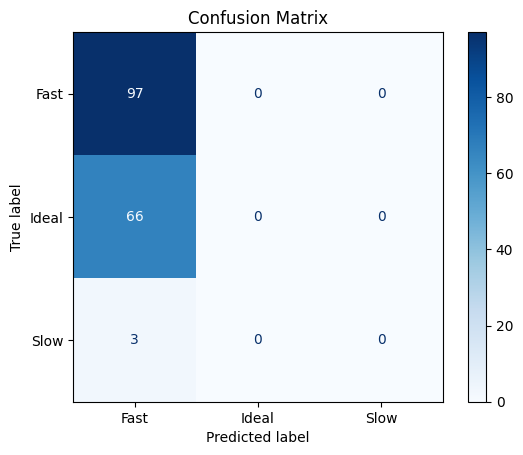

In [17]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Confusion matrix
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=le.classes_)
disp.plot(cmap='Blues')
plt.title("Confusion Matrix")
plt.show()


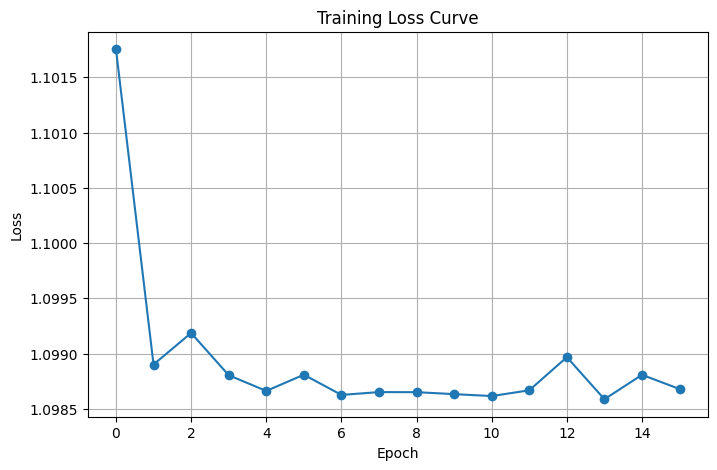

In [12]:
# Plot the loss curve
plt.figure(figsize=(8,5))
plt.plot(clf.loss_curve_, marker='o')
plt.title("Training Loss Curve")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.grid(True)
plt.show()


In [11]:
from sklearn.metrics import accuracy_score

accuracy = accuracy_score(y_test, y_pred)
print(f"Test Accuracy: {accuracy:.2f}")


Test Accuracy: 0.58


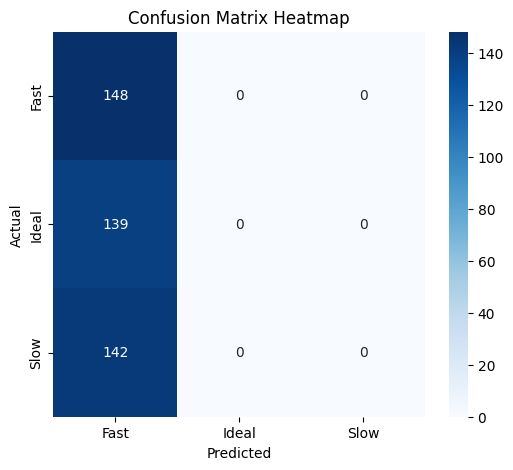

In [13]:
import seaborn as sns

plt.figure(figsize=(6,5))
sns.heatmap(cm, annot=True, fmt='d', xticklabels=le.classes_, yticklabels=le.classes_, cmap="Blues")
plt.title("Confusion Matrix Heatmap")
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.show()


In [13]:
# Predict the speech rate of a new audio file
new_path = "../WAVs/AUDIO-2025-04-03-21-02-43.wav"

try:
    # Extract MFCC features
    new_features = extract_mfcc(new_path).reshape(1, -1)
    
    # Normalize the features (if normalization was applied during training)
    new_features = scaler.transform(new_features)
    
    # Predict the label
    predicted_label = clf.predict(new_features)
    print("Predicted Speech Rate:", le.inverse_transform(predicted_label)[0])

except Exception as e:
    print(f"Error processing {new_path}: {e}")

Predicted Speech Rate: Fast


🔍 Transcribing...


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/whisper/transcribe.py:126: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")


▶️ Playing audio...


/var/folders/p8/f1p3n5w97ks_t8vzf5wcqblh0000gn/T/ipykernel_79098/3147762032.py:117: UserWarning: Glyph 129517 (\N{COMPASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 129517 (\N{COMPASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


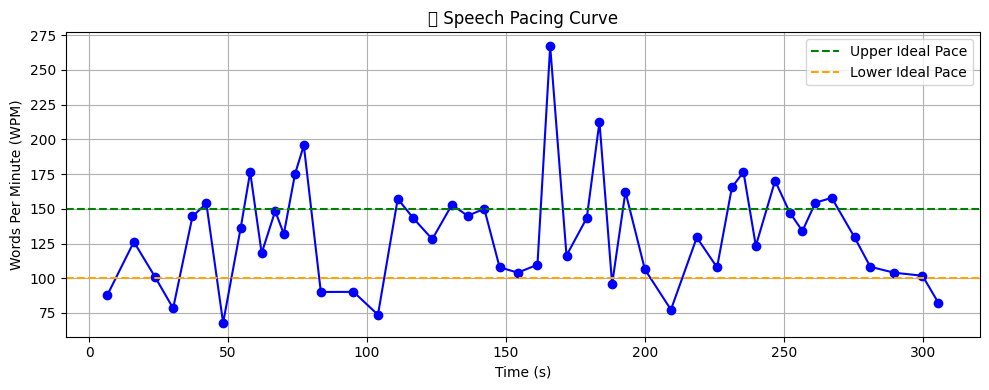


🎧 Final Summary
📄 Transcription: In this query, we can use HCeler index because if you use HCeler index, we can go for index only plan because this query use only a page attribute and salary attribute. So then without accessing emplo...
📈 Word Count: 544
⏱ Duration: 306.36 sec
⚖️ Average WPM: 106.54
🎯 Predicted Speech Rate (ML Model): Fast
✅ Confidence: 99.98%
💡 Feedback:
🟢 Your pace is within the ideal range. Good job keeping things clear and engaging.
⚠️ Your pace varied a lot. Work on maintaining a more consistent rhythm throughout.
🎯 Your tone and articulation suggest a fast delivery. Practice pausing briefly at natural breakpoints.


In [20]:
import whisper
import librosa
import numpy as np
import matplotlib.pyplot as plt
import os
from IPython.display import Audio, display

# Load Whisper model
model = whisper.load_model("base")

# Path to the audio file
file_path = "../WAVs/Ds_discoussion.wav"

def extract_mfcc(file_path):
    try:
        y, sr = librosa.load(file_path, sr=16000)
        mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)
        mfcc_mean = np.mean(mfcc, axis=1)
        return mfcc_mean
    except Exception as e:
        print(f"MFCC extraction failed: {e}")
        return np.zeros(13)

def generate_pacing_curve(segments):
    time_bins = []
    wpm_bins = []

    for seg in segments:
        start = seg['start']
        end = seg['end']
        words = seg['text'].strip().split()
        duration = end - start
        if duration > 0:
            wpm = len(words) / (duration / 60)
            time_bins.append((start + end) / 2)
            wpm_bins.append(wpm)

    return time_bins, wpm_bins

def generate_personalized_feedback(wpm_overall, std_wpm, pred_class):
    # Feedback based on WPM average
    if wpm_overall < 100:
        pace_tip = "🟡 You're speaking slowly. Try increasing your energy and reducing long pauses."
    elif wpm_overall > 150:
        pace_tip = "🔴 You're speaking quite fast. Consider slowing down to let your points sink in."
    else:
        pace_tip = "🟢 Your pace is within the ideal range. Good job keeping things clear and engaging."

    # Feedback based on consistency
    if std_wpm > 30:
        consistency_tip = "⚠️ Your pace varied a lot. Work on maintaining a more consistent rhythm throughout."
    else:
        consistency_tip = "✅ Your pacing is steady, which helps keep the audience comfortable."

    # Feedback based on acoustic model prediction
    model_feedback = {
        "Fast": "🎯 Your tone and articulation suggest a fast delivery. Practice pausing briefly at natural breakpoints.",
        "Ideal": "🎯 Your voice and rhythm sound well-paced. Keep practicing with real-time feedback to stay sharp.",
        "Slow": "🎯 Your delivery may sound hesitant or overly careful. Try speaking a bit more naturally and confidently."
    }

    return f"{pace_tip}\n{consistency_tip}\n{model_feedback[pred_class]}"

try:
    # Step 1: Transcription
    print("🔍 Transcribing...")
    result = model.transcribe(file_path, word_timestamps=True)
    transcription = result['text'].strip()
    segments = result['segments']

    # Step 2: Audio Playback
    print("▶️ Playing audio...")
    display(Audio(file_path))

    # Step 3: WPM Over Time
    time_bins, wpm_bins = generate_pacing_curve(segments)

    # Step 4: Overall Metrics
    y, sr = librosa.load(file_path, sr=16000)
    duration_sec = librosa.get_duration(y=y, sr=sr)
    word_count = len(transcription.split())
    wpm_overall = word_count / (duration_sec / 60)
    std_wpm = np.std(wpm_bins)

    # Step 5: MFCC + Model Prediction
    from joblib import load
    from sklearn.preprocessing import StandardScaler
    clf = load("mlp_classifier.pkl")
    scaler = load("scaler.pkl") if os.path.exists("scaler.pkl") else StandardScaler()

    features = extract_mfcc(file_path).reshape(1, -1)
    features_scaled = scaler.transform(features)
    pred_label = clf.predict(features_scaled)[0]

    # Adjust this if your label encoding is different
    label_map = {0: "Fast", 1: "Ideal", 2: "Slow"}
    pred_class = label_map[pred_label]

    probs = clf.predict_proba(features_scaled)[0]
    sorted_probs = np.sort(probs)
    confidence_gap = (sorted_probs[-1] - sorted_probs[-2]) * 100
    confidence = round(confidence_gap, 2)

    # Step 6: Generate Final Feedback
    pacing_feedback = generate_personalized_feedback(wpm_overall, std_wpm, pred_class)

    # Step 7: Plot Pacing Curve
    plt.figure(figsize=(10, 4))
    plt.plot(time_bins, wpm_bins, marker='o', linestyle='-', color='blue')
    plt.axhline(150, color='green', linestyle='--', label='Upper Ideal Pace')
    plt.axhline(100, color='orange', linestyle='--', label='Lower Ideal Pace')
    plt.title("🧭 Speech Pacing Curve")
    plt.xlabel("Time (s)")
    plt.ylabel("Words Per Minute (WPM)")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Final Output
    print("\n🎧 Final Summary")
    print("📄 Transcription:", transcription[:200] + "..." if len(transcription) > 200 else transcription)
    print("📈 Word Count:", word_count)
    print("⏱ Duration:", f"{duration_sec:.2f} sec")
    print("⚖️ Average WPM:", f"{wpm_overall:.2f}")
    print("🎯 Predicted Speech Rate (ML Model):", pred_class)
    print("✅ Confidence:", f"{confidence:.2f}%")
    print("💡 Feedback:\n" + pacing_feedback)

except Exception as e:
    print(f"❌ Error during processing: {e}")
